In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [4]:
import numpy as np
from tqdm import tqdm
from pathlib import Path
import openslide
import pandas as pd
import pickle

In [5]:
from fastai.callbacks.csv_logger import CSVLogger

In [6]:
from object_detection_fastai.helper.object_detection_helper import *
from object_detection_fastai.helper.wsi_loader import *
from object_detection_fastai.loss.RetinaNetFocalLoss import RetinaNetFocalLoss
from object_detection_fastai.models.RetinaNet import RetinaNet
from object_detection_fastai.callbacks.callbacks import BBLossMetrics, BBMetrics, PascalVOCMetric, PascalVOCMetricByDistance

In [7]:
slides_train = list(set(['BAL Promyk Spray 4.svs',
                         'BAL AIA Blickfang Luft.svs']))

slides_val = list(set(['BAL 1 Spray 2.svs', 
                         'BAL Booker Spray 3.svs',
                         'BAL Bubi Spray 1.svs', 
                         'BAL cent blue Luft 2.svs']))

labels = ['Mastzellen', "Makrophagen", "Neutrophile", "Eosinophile", "Lymohozyten"]

In [ ]:
experiment_name = "Asthma-L0-Screening"

In [9]:
annotations_path = Path("../Statistics/Asthma_Annotations.pkl")
annotations = pd.read_pickle(annotations_path)

annotations = annotations[annotations["class"].isin(labels)]
annotations_train = annotations[annotations["image_name"].isin(slides_train)]
annotations_val = annotations[annotations["image_name"].isin(slides_val)]
annotations_train.head()

,id,image_id,image_name,image_set,class,vector,unique_identifier,user_id,deleted,last_editor
21105,140917,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14371, 'x2': 14435, 'y1': 14738, 'y2': ...",2c2f610e-f4f7-4e05-8236-ffa28418550d,10,False,None
21106,140918,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14066, 'x2': 14152, 'y1': 14692, 'y2': ...",bcf159fc-2a41-4a69-a4cd-9b48da8fc663,10,False,None
21107,140919,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14377, 'x2': 14451, 'y1': 14646, 'y2': ...",f5e247d5-9c38-4e22-9329-56805024cf83,10,False,None
21108,140920,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14304, 'x2': 14384, 'y1': 14600, 'y2': ...",f68910d0-eb8f-4715-ad8d-accd060efff1,10,False,None
21109,140921,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14318, 'x2': 14402, 'y1': 14544, 'y2': ...",013f3fc1-b603-41ce-8357-e446db2c9a14,10,False,None


In [10]:
annotations["width"] = [vector["x2"] - vector["x1"] for vector in annotations["vector"]]
annotations["height"] = [vector["y2"] - vector["y1"] for vector in annotations["vector"]]
annotations["scale"] = annotations["width"] / annotations["height"]

<AxesSubplot:xlabel='width', ylabel='height'>

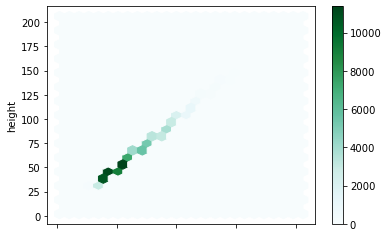

In [11]:
annotations.plot.hexbin(x='width', y='height', gridsize=25) #C='scale', 

In [12]:
slides_path = Path("../Slides")
files = {slide.name: slide for slide in slides_path.rglob("*.svs") if slide.name in slides_train + slides_val}
files

{'BAL 1 Spray 2.svs': WindowsPath('../Slides/BAL 1 Spray 2.svs'),
 'BAL AIA Blickfang Luft.svs': WindowsPath('../Slides/BAL AIA Blickfang Luft.svs'),
 'BAL Booker Spray 3.svs': WindowsPath('../Slides/BAL Booker Spray 3.svs'),
 'BAL Bubi Spray 1.svs': WindowsPath('../Slides/BAL Bubi Spray 1.svs'),
 'BAL cent blue Luft 2.svs': WindowsPath('../Slides/BAL cent blue Luft 2.svs'),
 'BAL Promyk Spray 4.svs': WindowsPath('../Slides/BAL Promyk Spray 4.svs')}

In [13]:
with open('../Statistics/Screening.pickle', 'rb') as handle:
    screening_modes = pickle.load(handle)

In [16]:
def filterAnnotations(image_name, xmin, ymin, screening_modes, patch_x:int = 1024, patch_y:int = 1024):
    
    screening = screening_modes[image_name]
    tiles = screening["screening_tiles"]  
    
    xmin, ymin = max(1, int(xmin - patch_x / 2)), max(1, int(ymin - patch_y / 2))
    
    x_step = int(np.floor(xmin / screening["x_resolution"]))
    y_step = int(np.floor(ymin / screening["y_resolution"]))
    
    return tiles[str((y_step * screening["x_steps"]) + x_step)]['Screened']

In [18]:
annotations = annotations[annotations.apply(lambda x: filterAnnotations(x["image_name"], x["vector"]["x1"], x["vector"]["y1"], screening_modes), axis=1)]
annotations.head()

,id,image_id,image_name,image_set,class,vector,unique_identifier,user_id,deleted,last_editor,width,height,scale
1811,185024,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13221, 'x2': 13287, 'y1': 9550, 'y2': 9...",7583907f-15d5-413b-b42a-0e32dfc82c0b,10,False,None,66,66,1.0
1817,185030,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13207, 'x2': 13291, 'y1': 9862, 'y2': 9...",7f227da9-6224-47da-a136-c02e96db91fc,10,False,None,84,84,1.0
1818,185031,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13292, 'x2': 13384, 'y1': 9883, 'y2': 9...",2ac02584-8640-47f4-aa07-68ebfc0d43ef,10,False,None,92,92,1.0
1819,185032,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13436, 'x2': 13510, 'y1': 9760, 'y2': 9...",062ae046-b00f-4993-a09d-fcf2f017ec2c,10,False,None,74,74,1.0
1821,185034,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13619, 'x2': 13717, 'y1': 9868, 'y2': 9...",a6cc39d5-302e-4298-9dda-a3082a4ca853,10,False,None,98,98,1.0


In [19]:
size = 1024 
level = 0
bs = 16
train_images = 500
val_images = 500

In [20]:
train_files = []
val_files = []

In [21]:
for image_name in annotations_train["image_name"].unique():
    
    annotations = annotations_train[annotations_train["image_name"] == image_name]
    annotations = annotations[annotations["deleted"] == False]
    
    slide_path = files[image_name]
    labels =  list(annotations["class"])
    bboxes = [[vector["x1"], vector["y1"], vector["x2"], vector["y2"]] for vector in annotations["vector"]]
    
    for label in labels:
        if label not in set(labels):
            bboxes.append([0,0,0,0])
            labels.append(label)

    train_files.append(SlideContainer(slide_path, y=[bboxes, labels],  level=level, width=size, height=size))
    
for image_name in annotations_val["image_name"].unique():
    
    annotations = annotations_val[annotations_val["image_name"] == image_name]
    annotations = annotations[annotations["deleted"] == False]
    
    slide_path = files[image_name]
    labels =  list(annotations["class"])
    bboxes = [[vector["x1"], vector["y1"], vector["x2"], vector["y2"]] for vector in annotations["vector"]]
    
    for label in labels:
        if label not in set(labels):
            bboxes.append([0,0,0,0])
            labels.append(label)

    val_files.append(SlideContainer(slide_path, y=[bboxes, labels],  level=level, width=size, height=size))

train_files = list(np.random.choice(train_files, train_images))
valid_files = list(np.random.choice(val_files, val_images))

In [22]:
tfms = get_transforms(do_flip=True,
                      flip_vert=True,
                      #max_rotate=90,
                      #max_lighting=0.0,
                      #max_zoom=1.,
                      #max_warp=0.0,
                      #p_affine=0.5,
                      #p_lighting=0.0,
                      #xtra_tfms=xtra_tfms,
                     )

In [23]:
def get_y_func(x):
    return x.y

In [24]:
train =  ObjectItemListSlide(train_files, path=slides_path)
valid = ObjectItemListSlide(valid_files, path=slides_path)
item_list = ItemLists(slides_path, train, valid)
lls = item_list.label_from_func(get_y_func, label_cls=SlideObjectCategoryList) #
lls = lls.transform(tfms, tfm_y=True, size=size)
data = lls.databunch(bs=bs, collate_fn=bb_pad_collate, num_workers=0).normalize()

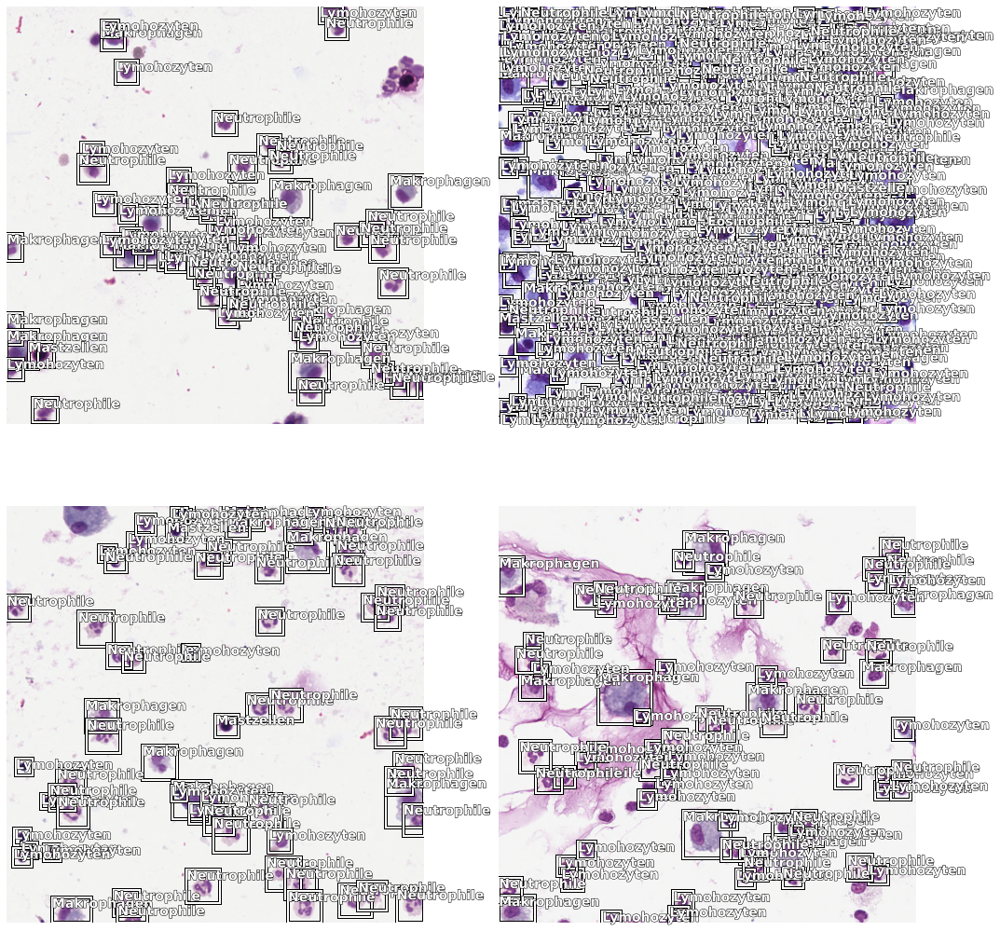

In [26]:
data.show_batch(rows=2, ds_type=DatasetType.Valid, figsize=(15,15))

In [27]:
scales = [.8, .9, 1, 1.1]
anchors = create_anchors(sizes=[(64, 64), (32,32)], ratios=[1], scales=scales)

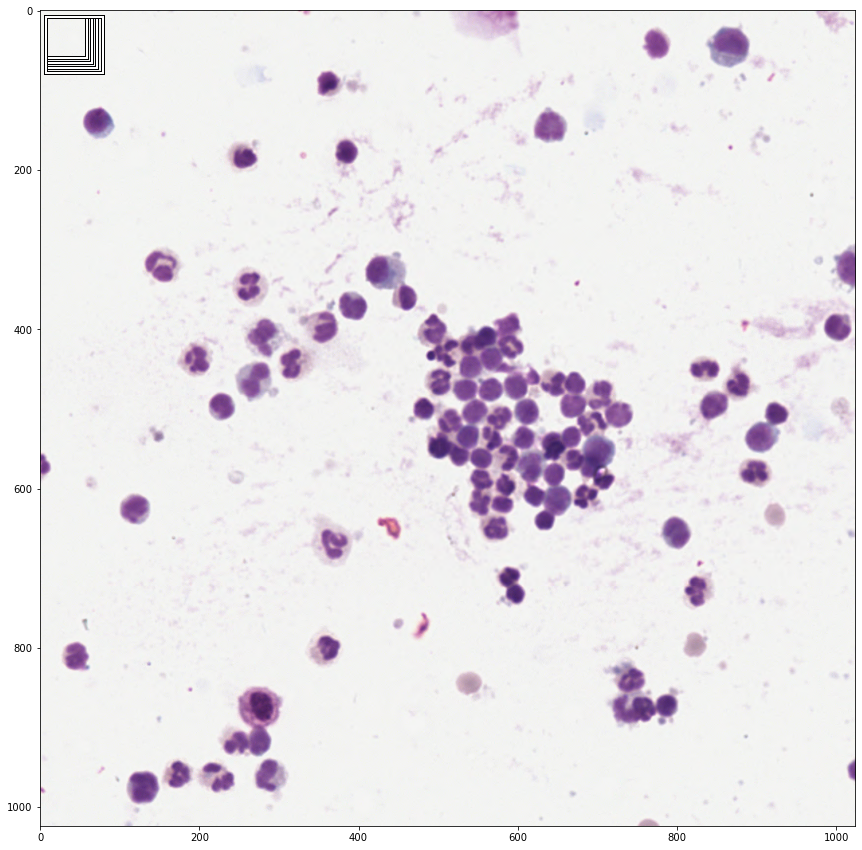

In [28]:
fig,ax = plt.subplots(figsize=(15,15))
ax.imshow(image2np(data.valid_ds[0][0].data))

for i, bbox in enumerate(anchors[:len(scales)]):
    bb = bbox.numpy()
    x = (bb[0] + 1) * size / 2 
    y = (bb[1] + 1) * size / 2 
    w = bb[2] * size / 2
    h = bb[3] * size / 2
    
    rect = [x,y,w,h]
    draw_rect(ax,rect)

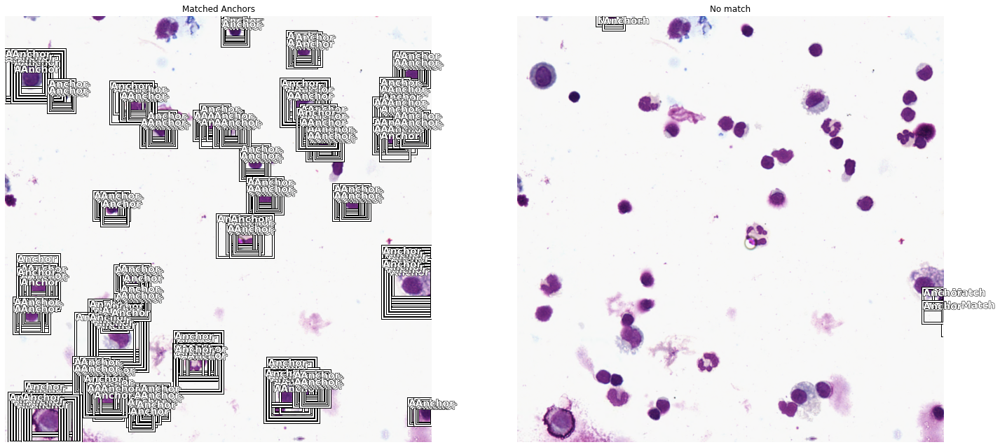

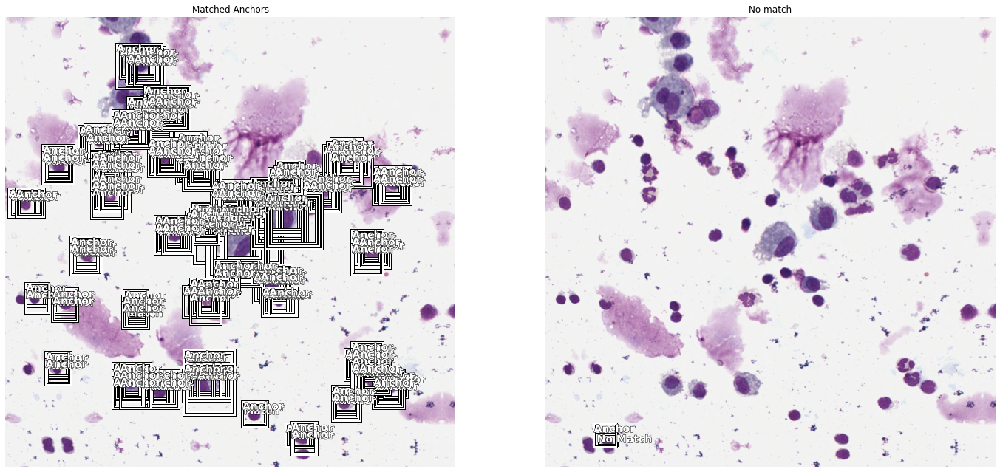

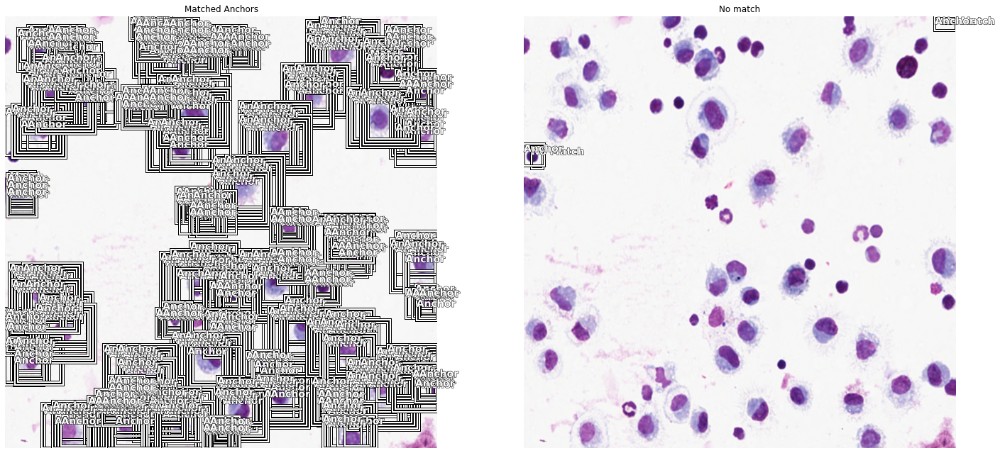

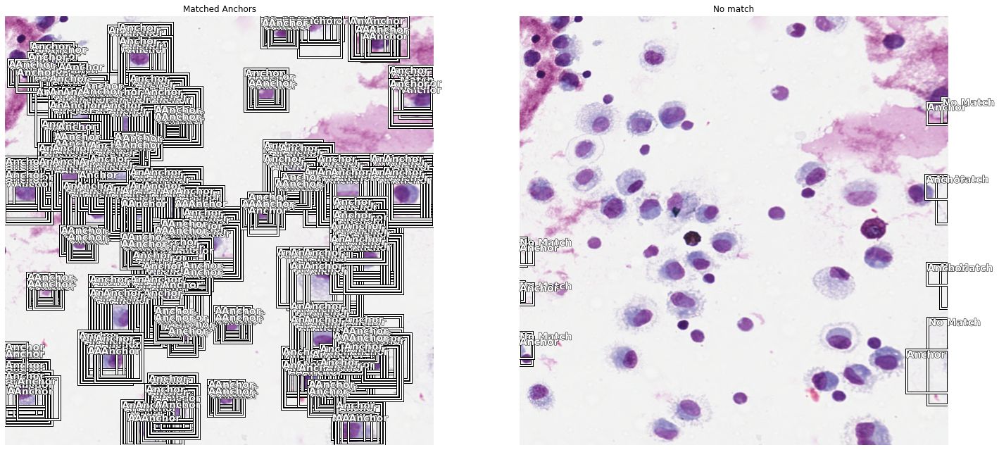

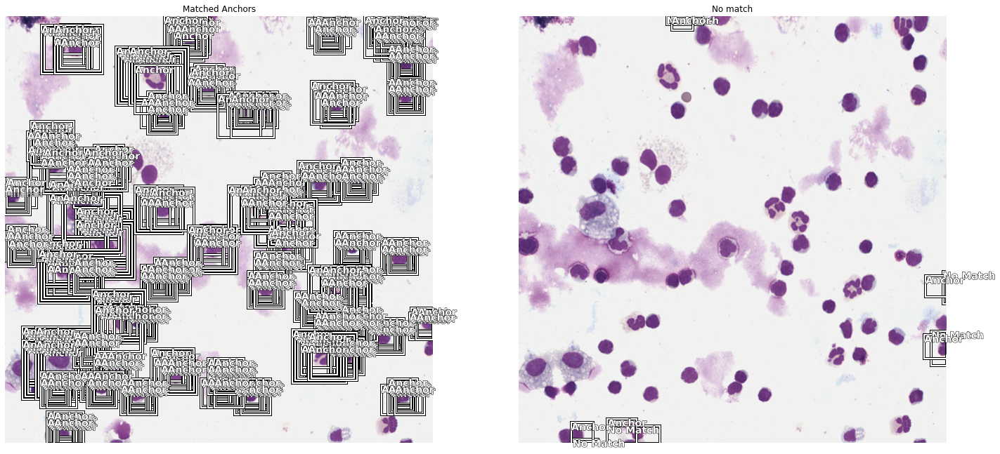

...

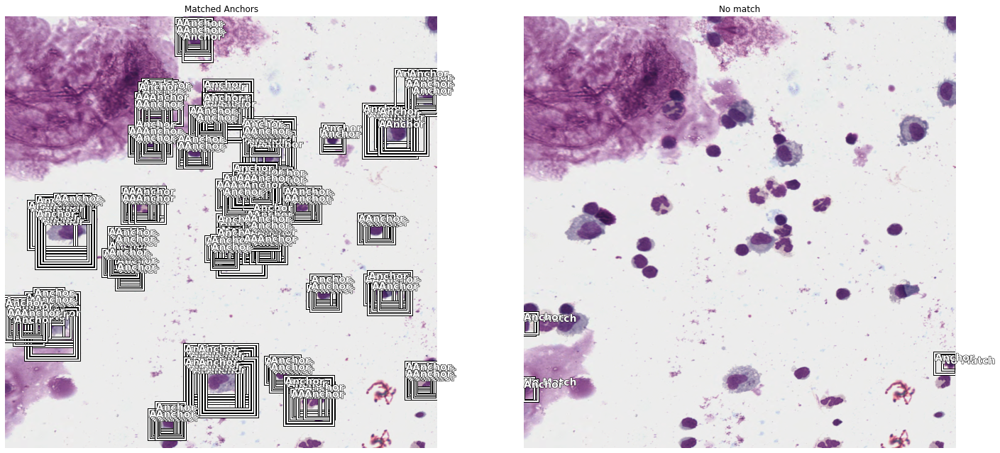

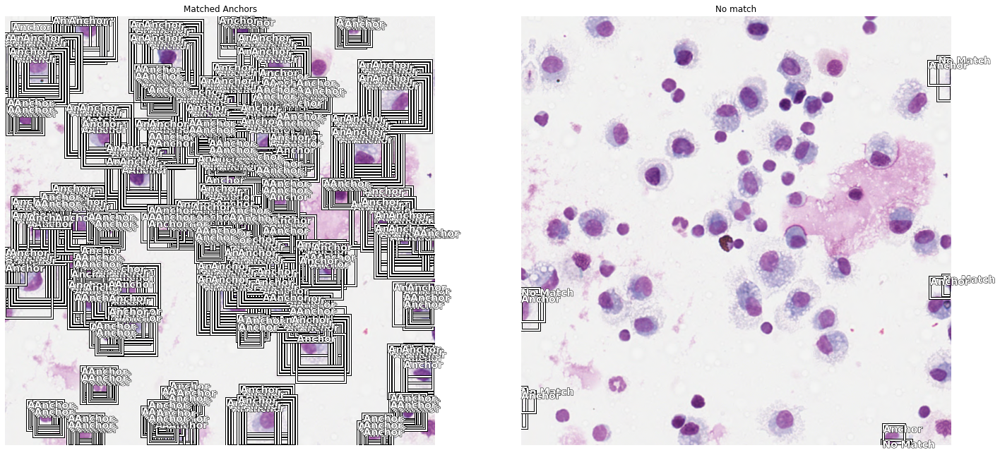

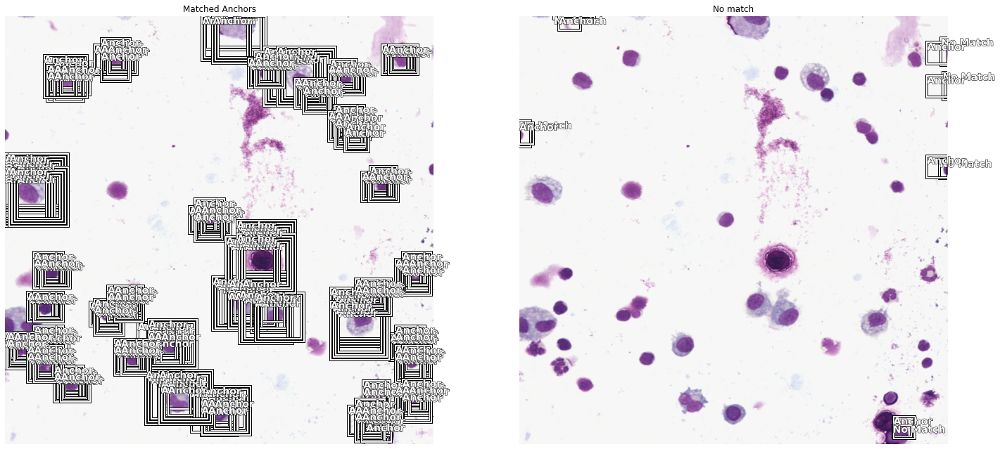

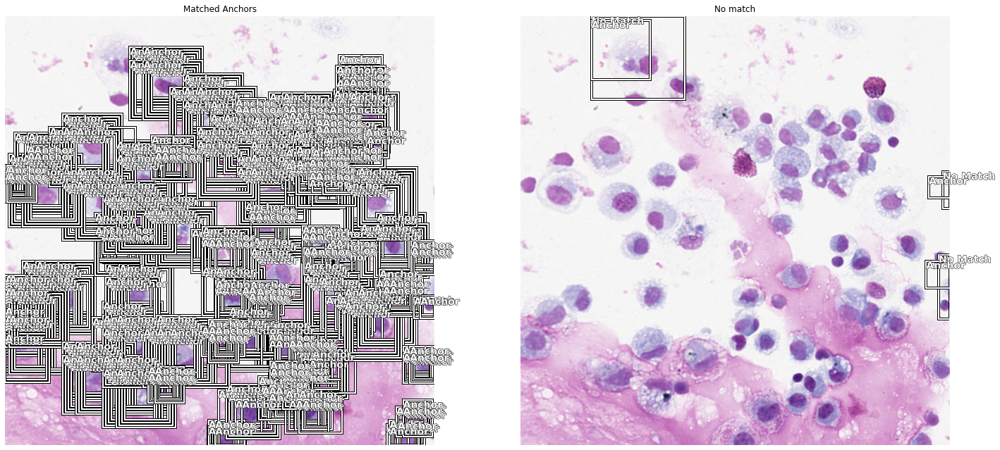

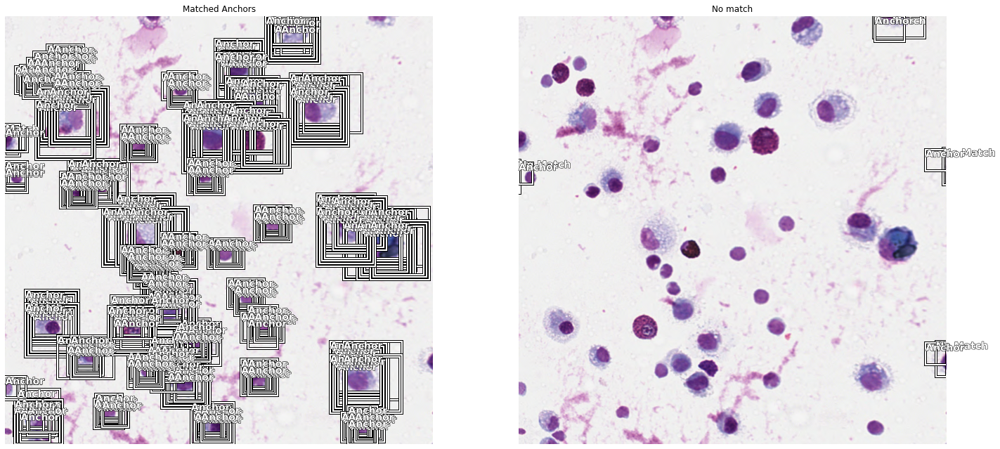

In [21]:
all_boxes, all_labels = show_anchors_on_images(data, anchors, figsize=(24, 24))

In [29]:
crit = RetinaNetFocalLoss(anchors)

encoder = create_body(models.resnet18, True, -2)
model = RetinaNet(encoder, n_classes=data.train_ds.c, n_anchors=len(scales), sizes=[64, 32], chs=128, final_bias=-4., n_conv=2)

In [30]:
data.train_ds.y.classes[1:]

['Eosinophile', 'Lymohozyten', 'Makrophagen', 'Mastzellen', 'Neutrophile']

In [31]:
voc = PascalVOCMetricByDistance(anchors, size, [str(i) for i in data.train_ds.y.classes[1:]], radius=40)
learn = Learner(data, model, loss_func=crit, callback_fns=[BBMetrics], #BBMetrics, ShowGraph
                metrics=[voc])

In [32]:
learn.split([model.encoder[6], model.c5top5])
learn.freeze_to(-2)

In [34]:
learn.fit_one_cycle(3, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.317162,1.314574,0.368804,0.197588,1.116986,0.034836,0.476796,0.552732,0.345168,0.434486,15:30
1,0.292248,0.730877,0.441779,0.154643,0.576235,0.284737,0.444091,0.606095,0.347913,0.526059,13:52
2,0.262853,0.837690,0.493384,0.149400,0.688290,0.418137,0.458230,0.623451,0.423597,0.543503,13:48


In [35]:
learn.unfreeze()
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.230665,0.838421,0.530058,0.174847,0.663574,0.501038,0.512258,0.654724,0.440144,0.542124,14:32
1,0.240927,0.948303,0.402820,0.174846,0.773457,0.247089,0.474604,0.687099,0.244069,0.361240,14:07
2,0.271151,0.880189,0.543348,0.203518,0.676671,0.582600,0.456120,0.634331,0.426967,0.616720,13:43
3,0.252913,0.791981,0.536892,0.143729,0.648252,0.506836,0.526972,0.631415,0.498993,0.520242,14:33
4,0.234397,1.035334,0.475457,0.144415,0.890920,0.176091,0.524161,0.614279,0.534166,0.528587,14:23
5,0.214171,0.678671,0.555923,0.141228,0.537444,0.627891,0.504542,0.625766,0.511458,0.509959,14:18
6,0.198238,0.864363,0.591557,0.163664,0.700699,0.615346,0.502009,0.675522,0.496439,0.668471,14:00
7,0.181761,0.704045,0.579989,0.124654,0.579390,0.593885,0.499016,0.662537,0.546429,0.598076,13:51
8,0.166968,0.461839,0.591481,0.101962,0.359877,0.658377,0.487219,0.669746,0.538696,0.603364,14:50
9,0.159276,0.587873,0.580845,0.108113,0.479760,0.624079,0.481073,0.658261,0.541833,0.598978,13:35


In [36]:
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.147760,0.682339,0.598093,0.108507,0.573831,0.709078,0.501281,0.646240,0.538155,0.595711,12:41
1,0.162115,0.627628,0.558451,0.134497,0.493132,0.586846,0.495762,0.609397,0.449052,0.651199,13:23
2,0.183954,0.662450,0.509988,0.143721,0.518728,0.438493,0.507736,0.648605,0.319620,0.635486,13:33
3,0.210961,0.498916,0.553332,0.125873,0.373042,0.459765,0.511893,0.652172,0.510497,0.632335,13:47
4,0.196226,0.723304,0.579186,0.115541,0.607763,0.675102,0.499008,0.659779,0.493505,0.568539,13:24
5,0.182379,0.560558,0.484934,0.137911,0.422647,0.300401,0.489735,0.620699,0.475496,0.538339,12:39
6,0.173108,0.584030,0.575523,0.100931,0.483100,0.548870,0.488308,0.661557,0.593488,0.585393,13:17
7,0.161620,0.838842,0.555362,0.096040,0.742802,0.488828,0.494006,0.663584,0.501543,0.628847,12:38
8,0.150781,0.806210,0.584999,0.105763,0.700447,0.581794,0.473158,0.653180,0.564053,0.652810,12:11
9,0.143184,0.507643,0.593572,0.102985,0.404658,0.601606,0.493872,0.666609,0.573161,0.632613,13:42


In [37]:
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.135898,0.467139,0.599757,0.101381,0.365758,0.695687,0.504684,0.655075,0.544575,0.598764,13:24
1,0.142510,0.582049,0.582850,0.156041,0.426008,0.679337,0.438370,0.614052,0.555612,0.626876,12:49
2,0.160132,0.546876,0.569179,0.111821,0.435055,0.554372,0.468053,0.672659,0.616322,0.534487,13:28
3,0.167946,1.021812,0.566506,0.132871,0.888941,0.588061,0.436205,0.678066,0.512614,0.617586,11:50
4,0.167753,0.537258,0.596890,0.121060,0.416198,0.794797,0.521860,0.615552,0.499019,0.553220,13:23
5,0.164781,0.839190,0.557278,0.139910,0.699280,0.418241,0.490711,0.664354,0.600769,0.612317,12:54
6,0.153776,0.823051,0.594560,0.110853,0.712198,0.718212,0.488458,0.663403,0.485176,0.617549,13:10
7,0.145036,0.530055,0.620376,0.098228,0.431827,0.722291,0.494443,0.622916,0.618733,0.643498,12:48
8,0.138003,0.838235,0.564776,0.107332,0.730903,0.550115,0.492563,0.618861,0.532018,0.630325,13:35
9,0.132871,0.555148,0.605079,0.101236,0.453913,0.657119,0.492881,0.646153,0.584640,0.644604,13:13


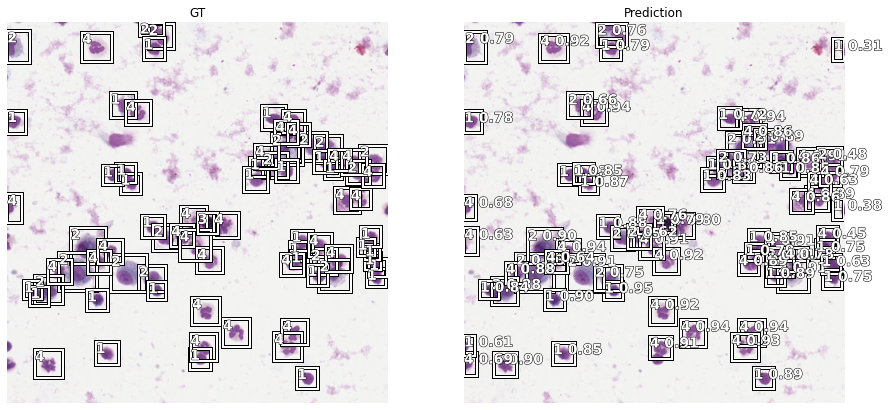

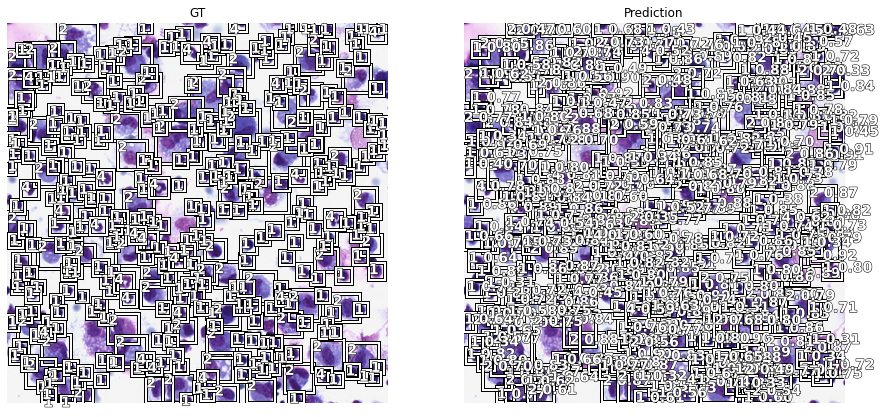

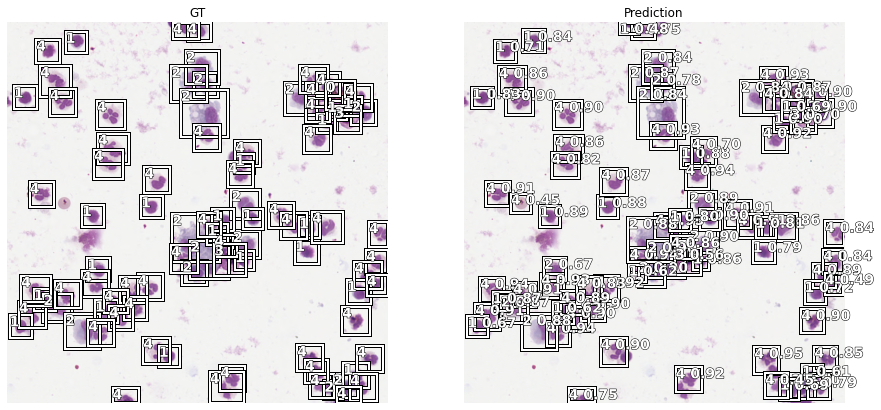

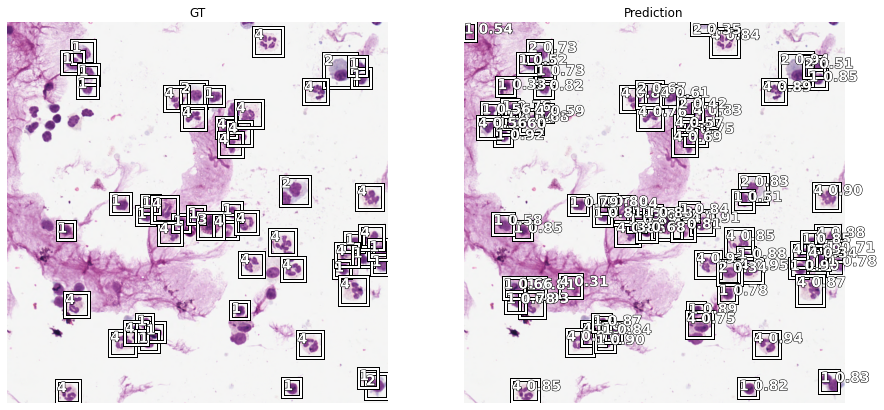

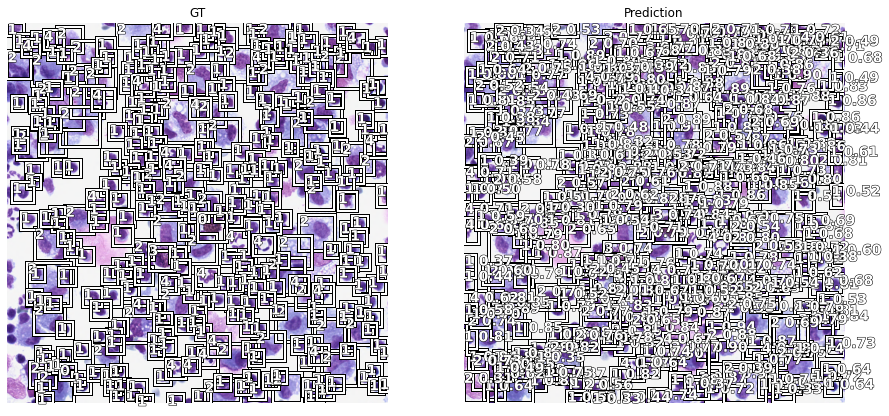

In [38]:
slide_object_result(learn, anchors, detect_thresh=0.3, nms_thresh=0.2)

In [39]:
data.c

6

In [40]:
import pickle

stats = {"anchors": anchors,
         "mean": to_np(data.stats[0]),
         "std": to_np(data.stats[1]),
         "size": size,
         "n_classes": data.c,
         "n_anchors": len(scales),
         "sizes": [64, 32],
         "chs": 128,
         "encoder": "RN-18",
         "n_conv": 2,
         "level": 0,
         "model": get_model(learn.model).state_dict()
        }

torch.save(stats, "{}.p".format(experiment_name))

In [41]:
data.classes 

['background',
 'Eosinophile',
 'Lymohozyten',
 'Makrophagen',
 'Mastzellen',
 'Neutrophile']